<a href="https://colab.research.google.com/github/ibrahimsar24/Youtube-Sentiment-Analysis/blob/main/Sentiment_Analysis_on_YouTube_Dataset.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# This is a 6 part Project based on YouTube Dataset

# Part 1: Sentiment Analysis

# Part 2: Performing EDA on Positive comments

# Part 3: Performing EDA on Negative comments

# Part 4: Analyzing the trending tags

# Part 5: Analyzing likes, dislikes and views to see the correlation between them

# Part 6: Analyzing Emojis

# Part 1: Performing Sentiment Analysis by calculating Polarity of each comment in our YouTube Dataset

##### Sentiment analysis is basically the process of determining the attitude 
##### or the emotion of the writer, i.e., whether it is positive or negative or neutral.

##### The sentiment function of textblob returns two properties, polarity, and subjectivity.

##### Polarity is float which lies in the range of [-1,1]
##### where 1 means positive statement and -1 means a negative statement. 
##### Subjective sentences generally refer to personal opinion, emotion or 
##### judgment whereas objective refers to factual information. 
##### Subjectivity is also a float which lies in the range of [0,1].

In [ ]:
# Importing libraries

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
# Reading data in a dataframe

# here error_bad_lines -->Lines with too many fields (e.g. a csv line with too many commas) 
# will by default cause an exception to be raised, 
# and no DataFrame will be returned. 
# If False, then these “bad lines” will 
# be dropped from the DataFrame that is returned. 

comments = pd.read_csv('GBcomments.csv',error_bad_lines = False,engine='python')

/Users/surajitshasmal/opt/anaconda3/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3444: FutureWarning: The error_bad_lines argument has been deprecated and will be removed in a future version.


  exec(code_obj, self.user_global_ns, self.user_ns)
b'Skipping line 113225: expected 4 fields, saw 5\n'
b'Skipping line 158379: expected 4 fields, saw 7\nSkipping line 241590: expected 4 fields, saw 5\nSkipping line 245637: expected 4 fields, saw 7\n'
b'Skipping line 521402: expected 4 fields, saw 5\n'


In [ ]:
# head() function will help us see the first five rows in our DataFrame

comments.head()

,video_id,comment_text,likes,replies
0,jt2OHQh0HoQ,It's more accurate to call it the M+ (1000) be...,0,0
1,jt2OHQh0HoQ,To be there with a samsung phone\n😂😂😂,1,0
2,jt2OHQh0HoQ,"Thank gosh, a place I can watch it without hav...",0,0
3,jt2OHQh0HoQ,What happened to the home button on the iPhone...,0,0
4,jt2OHQh0HoQ,Power is the disease. Care is the cure. Keep...,0,0


In [ ]:
# Checking for null values in the DataFrame

# isna() function is Checking if the DataFrame
# contains any null values

# sum() function is giving us the total null values in
# a particular column

comments.isna().sum()

video_id         0
comment_text    28
likes            0
replies          0
dtype: int64

In [ ]:
# Removing the null values from the DataFrame

comments.dropna(inplace = True)

In [ ]:
# Textblob is an open-source python library for processing textual data.
# It performs different operations on textual data 
# such as noun phrase extraction, sentiment analysis, 
# classification, translation, etc. 

# Here we are using pip to install textblob library

# pip is a package-management system written in Python used to install 
# and manage software packages. It connects to an online repository 
# of public packages, called the Python Package Index.

!pip install textblob

In [ ]:
#Importing the TextBlob library

from textblob import TextBlob

In [ ]:
# Creating an empty list to store th polarity of the comments

polarity=[]

# Starting the for loop to extract each row and then find it's
# corresponding polarity

# Here comment will take each row under "comment_text column of 
# our DataFrame named "comments"

for comment in comments['comment_text']:
    # append() --> This function will add the resultant value in the list named 'polarity'
    # TextBlob(comment).sentiment.polarity --> This function here is taking the particular comment as
    #                                          input and based on that returns its polarity
    polarity.append(TextBlob(comment).sentiment.polarity)

In [ ]:
# Adding the Polarity just calculated to the DataFrame

comments['polarity'] = polarity

#Seeing the first 5 rows in our DataFrame via head() function
comments.head()

,video_id,comment_text,likes,replies,polarity
0,jt2OHQh0HoQ,It's more accurate to call it the M+ (1000) be...,0,0,0.45
1,jt2OHQh0HoQ,To be there with a samsung phone\n😂😂😂,1,0,0.00
2,jt2OHQh0HoQ,"Thank gosh, a place I can watch it without hav...",0,0,0.00
3,jt2OHQh0HoQ,What happened to the home button on the iPhone...,0,0,0.00
4,jt2OHQh0HoQ,Power is the disease. Care is the cure. Keep...,0,0,1.00


In [ ]:
comments[comments['polarity']<0]

,video_id,comment_text,likes,replies,polarity
7,jt2OHQh0HoQ,You will never find Losers who line up and pay...,0,0,-0.100000
61,jt2OHQh0HoQ,25 Hours WTF,1,0,-0.500000
74,jt2OHQh0HoQ,fuck you beech,0,1,-0.400000
75,jt2OHQh0HoQ,piece of shit,0,1,-0.200000
87,jt2OHQh0HoQ,Apple is terrible and they only care about the...,0,0,-0.500000
...,...,...,...,...,...
718417,lLN1FwiqGwc,"IT 2017 is better, IT 1990 was fucking trash",0,0,-0.050000
718419,lLN1FwiqGwc,Your imitation of Moss is horrible and you sho...,1,0,-0.566667
718424,lLN1FwiqGwc,Couldn't lure awkward fanart to Tumblr...........,0,0,-0.250000
718428,lLN1FwiqGwc,24:28 absolutely killed me,0,0,-0.200000


# Part 2:  Performing EDA on Positive comments

In [ ]:
# Getting the positive polarity comments
# polarity == 1 represents positive comments

positive_comments = comments[comments['polarity']==1]

# Seeing First 5 rows of our positive 
# comments via head() function

positive_comments.head()

,video_id,comment_text,likes,replies,polarity
4,jt2OHQh0HoQ,Power is the disease. Care is the cure. Keep...,0,0,1.0
26,jt2OHQh0HoQ,The best thing to ever happen to iPhone,0,2,1.0
80,jt2OHQh0HoQ,Apple is always awesome \n\nhttps://youtu.be/r...,0,1,1.0
158,YPVcg45W0z4,das a lot of edditing you have done there ... ...,0,0,1.0
175,YPVcg45W0z4,Welcome to the Scandiworld!,0,0,1.0


In [ ]:
# Downloading wordcloud library to 
#perform Exploratory Data Analysis

!pip install wordcloud

In [ ]:
# Importing WordCloud and STOPWORDS classes
# from wordcloud library
from wordcloud import WordCloud, STOPWORDS


In [ ]:
# Stopwords --> A stop word is a commonly used word 
# (such as “the”, “a”, “an”, “in”)
# We would not want these words to take up space in our 
# DataFrame, or taking up valuable processing time. 
# For this, we can remove them easily, 
# by storing a list of words that you consider to stop words.

# set() function will give us an ordered list 
# with unique stop words arranged in ascending order

stopwords = set(STOPWORDS)

In [ ]:
# Joining all the comments in our positive_comment DataFrame
# as one to do text analysis and then create a Word Cloud
# on the most used words all throughout with varying sizes
# wherein size would define the frequency with which the word
# is occurring

# join() function --> It is a string method and returns 
# a string in which the elements of sequence have 
# been joined by str separator.
# Here we are joining all the comments with a ' '(space)

total_positive_comments = ' '.join(positive_comments['comment_text'])

In [ ]:
total_positive_comments

In [ ]:
# defining the canvas for word cloud and storing 
# it in a word cloud  object
# width     --> Width of the canvas. By default it is 400 
# height    --> Height of the canvas. By default it is 200
# stopwords --> The words that will be eliminated. 
# If None, the built-in STOPWORDS list will be used.

wordcloud_obj1 = WordCloud(stopwords=stopwords)

In [ ]:
# generate() function will Generate wordcloud from text

wordcloud_obj1.generate(total_positive_comments)


(-0.5, 399.5, 199.5, -0.5)

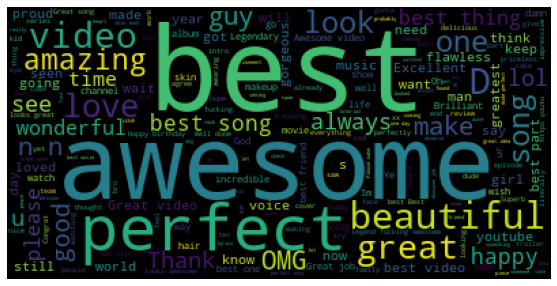

In [ ]:
# Plotting the generated Word Cloud

# The purpose of using plt.figure() is to create afigure object.
# figsize(float, float): These parameter are the 
# width, height in inches.

plt.figure(figsize=(15,5))

#  plt.imshow() function is used to display data as an image
plt.imshow(wordcloud_obj1)

# plt.axis() function is used to set some axis properties to the graph.
# eg --> plt.axis('off') is used to signify no axis
# eg --> plt.axis(0,10,1,15) is used to signify x axis will 
#        start from 0 and end at 10 and y axis will start 
#        from 1 and end at 15

plt.axis('off')

# Part 3:  Performing EDA on Negative comments

In [ ]:
# Getting the negative polarity comments
# polarity == -1 represents negative comments

negative_comments = comments[comments['polarity']<0]

# Seeing First 5 rows of our positive 
# comments via head() function

negative_comments.head()

,video_id,comment_text,likes,replies,polarity
7,jt2OHQh0HoQ,You will never find Losers who line up and pay...,0,0,-0.1
61,jt2OHQh0HoQ,25 Hours WTF,1,0,-0.5
74,jt2OHQh0HoQ,fuck you beech,0,1,-0.4
75,jt2OHQh0HoQ,piece of shit,0,1,-0.2
87,jt2OHQh0HoQ,Apple is terrible and they only care about the...,0,0,-0.5


In [ ]:
stopwords1 = stopwords

In [ ]:
stopwords1.add('people')

In [ ]:
# Joining all the comments in our negative_comment DataFrame
# as one to do text analysis and then create a Word Cloud
# on the most used words all throughout with varying sizes
# wherein size would define the frequency with which the word
# is occurring

# join() function --> It is a string method and returns 
# a string in which the elements of sequence have 
# been joined by str separator.
# Here we are joining all the comments with a ' '(space)

total_negative_comments = ' '.join(negative_comments['comment_text'])

In [ ]:
# defining the canvas for word cloud and storing 
# it in a word cloud  object
# width     --> Width of the canvas. By default it is 400 
# height    --> Height of the canvas. By default it is 200
# stopwords --> The words that will be eliminated. 
# If None, the built-in STOPWORDS list will be used.

wordcloud_obj2 = WordCloud(width = 1000, height=500,stopwords = stopwords1 )

In [ ]:
# generate() function will Generate wordcloud from text

wordcloud_obj2.generate(total_negative_comments)

(-0.5, 999.5, 499.5, -0.5)

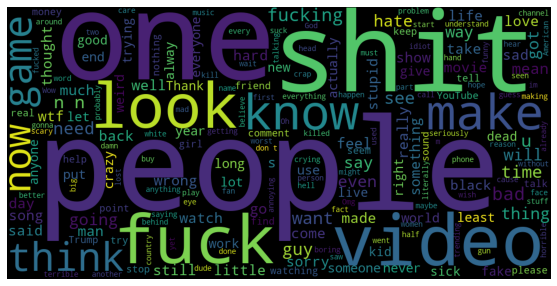

In [ ]:
# Plotting the generated Word Cloud

# The purpose of using plt.figure() is to create afigure object.
# figsize(float, float): These parameter are the 
# width, height in inches.

plt.figure(figsize=(15,5))

#  plt.imshow() function is used to display data as an image
plt.imshow(wordcloud_obj2)

# plt.axis() function is used to set some axis properties to the graph.
# eg --> plt.axis('off') is used to signify no axis
# eg --> plt.axis(0,10,1,15) is used to signify x axis will 
#        start from 0 and end at 10 and y axis will start 
#        from 1 and end at 15

plt.axis('off')

# Part 4: Analyzing the trending tags

In [ ]:
# Reading data in a dataframe

# here error_bad_lines -->Lines with too many fields (e.g. a csv line with too many commas) 
# will by default cause an exception to be raised, 
# and no DataFrame will be returned. 
# If False, then these “bad lines” will 
# be dropped from the DataFrame that is returned. 

USvideos = pd.read_csv('USvideos.csv',error_bad_lines = False,engine='python')

/Users/surajitshasmal/opt/anaconda3/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3444: FutureWarning: The error_bad_lines argument has been deprecated and will be removed in a future version.


  exec(code_obj, self.user_global_ns, self.user_ns)


In [ ]:
# head() function will help us see the first five rows in our DataFrame

USvideos.head()

,video_id,trending_date,title,channel_title,category_id,publish_time,tags,views,likes,dislikes,comment_count,thumbnail_link,comments_disabled,ratings_disabled,video_error_or_removed,description
0,2kyS6SvSYSE,17.14.11,WE WANT TO TALK ABOUT OUR MARRIAGE,CaseyNeistat,22,2017-11-13T17:13:01.000Z,SHANtell martin,748374,57527,2966,15954,https://i.ytimg.com/vi/2kyS6SvSYSE/default.jpg,False,False,False,SHANTELL'S CHANNEL - https://www.youtube.com/s...
1,1ZAPwfrtAFY,17.14.11,The Trump Presidency: Last Week Tonight with J...,LastWeekTonight,24,2017-11-13T07:30:00.000Z,"last week tonight trump presidency|""last week ...",2418783,97185,6146,12703,https://i.ytimg.com/vi/1ZAPwfrtAFY/default.jpg,False,False,False,"One year after the presidential election, John..."
2,5qpjK5DgCt4,17.14.11,"Racist Superman | Rudy Mancuso, King Bach & Le...",Rudy Mancuso,23,2017-11-12T19:05:24.000Z,"racist superman|""rudy""|""mancuso""|""king""|""bach""...",3191434,146033,5339,8181,https://i.ytimg.com/vi/5qpjK5DgCt4/default.jpg,False,False,False,WATCH MY PREVIOUS VIDEO ▶ \n\nSUBSCRIBE ► http...
3,puqaWrEC7tY,17.14.11,Nickelback Lyrics: Real or Fake?,Good Mythical Morning,24,2017-11-13T11:00:04.000Z,"rhett and link|""gmm""|""good mythical morning""|""...",343168,10172,666,2146,https://i.ytimg.com/vi/puqaWrEC7tY/default.jpg,False,False,False,Today we find out if Link is a Nickelback amat...
4,d380meD0W0M,17.14.11,I Dare You: GOING BALD!?,nigahiga,24,2017-11-12T18:01:41.000Z,"ryan|""higa""|""higatv""|""nigahiga""|""i dare you""|""...",2095731,132235,1989,17518,https://i.ytimg.com/vi/d380meD0W0M/default.jpg,False,False,False,I know it's been a while since we did this sho...


In [ ]:
# Joining all the tags in ourUSvideos DataFrame
# as one to do text analysis and then create a Word Cloud
# on the most frequently used tags all throughout with varying sizes
# wherein size would define the frequency with which the tag
# is occurring

# join() function --> It is a string method and returns 
# a string in which the elements of sequence have 
# been joined by str separator.
# Here we are joining all the comments with a ' '(space)

complete_tags=' '.join(USvideos['tags'])

In [ ]:
complete_tags

'SHANtell martin last week tonight trump presidency|"last week tonight donald trump"|"john oliver trump"|"donald trump" racist superman|"rudy"|"mancuso"|"king"|"bach"|"racist"|"superman"|"love"|"rudy mancuso poo bear black white official music video"|"iphone x by pineapple"|"lelepons"|"hannahstocking"|"rudymancuso"|"inanna"|"anwar"|"sarkis"|"shots"|"shotsstudios"|"alesso"|"anitta"|"brazil"|"Getting My Driver\'s License | Lele Pons" rhett and link|"gmm"|"good mythical morning"|"rhett and link good mythical morning"|"good mythical morning rhett and link"|"mythical morning"|"Season 12"|"nickelback lyrics"|"nickelback lyrics real or fake"|"nickelback"|"nickelback songs"|"nickelback song"|"rhett link nickelback"|"gmm nickelback"|"lyrics (website category)"|"nickelback (musical group)"|"rock"|"music"|"lyrics"|"chad kroeger"|"canada"|"music (industry)"|"mythical"|"gmm challenge"|"comedy"|"funny"|"challenge" ryan|"higa"|"higatv"|"nigahiga"|"i dare you"|"idy"|"rhpc"|"dares"|"no truth"|"comments

In [ ]:
# In the above tags which we combined, there was some
# noise in the data
# Noise can be any character other than a-z or A-z like
# special characters and extra spaces
# We need to remove those before we start to analyze the
# tags
# This can be done by using specific functions of regex 
# library like sub() function

# Importing regEx library

import re

In [ ]:
# re.sub() function is used to replace occurrences of a 
# particular sub-string with another sub-string.
# This function takes as input the following:
# i)   The sub-string to replace
# ii)  The sub-string to replace with
# iii) The actual string

tags = re.sub('[^a-zA-Z]',' ', complete_tags)

# In the above statement we replaced anything which wasnt a 
# character between a to z OR A to Z with a single space
# Still we can see there are consecutive multiple spaces
# present in tags which need to be replaced with a single
# space

# Here ' +' --> It represents when there are 2 or more spaces
# occurring consecutively
tags

'SHANtell martin last week tonight trump presidency  last week tonight donald trump   john oliver trump   donald trump  racist superman  rudy   mancuso   king   bach   racist   superman   love   rudy mancuso poo bear black white official music video   iphone x by pineapple   lelepons   hannahstocking   rudymancuso   inanna   anwar   sarkis   shots   shotsstudios   alesso   anitta   brazil   Getting My Driver s License   Lele Pons  rhett and link  gmm   good mythical morning   rhett and link good mythical morning   good mythical morning rhett and link   mythical morning   Season      nickelback lyrics   nickelback lyrics real or fake   nickelback   nickelback songs   nickelback song   rhett link nickelback   gmm nickelback   lyrics  website category    nickelback  musical group    rock   music   lyrics   chad kroeger   canada   music  industry    mythical   gmm challenge   comedy   funny   challenge  ryan  higa   higatv   nigahiga   i dare you   idy   rhpc   dares   no truth   comments 

In [ ]:
tags = re.sub(' +',' ', tags)
tags


'SHANtell martin last week tonight trump presidency last week tonight donald trump john oliver trump donald trump racist superman rudy mancuso king bach racist superman love rudy mancuso poo bear black white official music video iphone x by pineapple lelepons hannahstocking rudymancuso inanna anwar sarkis shots shotsstudios alesso anitta brazil Getting My Driver s License Lele Pons rhett and link gmm good mythical morning rhett and link good mythical morning good mythical morning rhett and link mythical morning Season nickelback lyrics nickelback lyrics real or fake nickelback nickelback songs nickelback song rhett link nickelback gmm nickelback lyrics website category nickelback musical group rock music lyrics chad kroeger canada music industry mythical gmm challenge comedy funny challenge ryan higa higatv nigahiga i dare you idy rhpc dares no truth comments comedy funny stupid fail ijustine week with iPhone X iphone x apple iphone iphone x review iphone x unboxing SNL Saturday Night 

In [ ]:
# defining the canvas for word cloud and storing 
# it in a word cloud  object
# width     --> Width of the canvas. By default it is 400 
# height    --> Height of the canvas. By default it is 200
# stopwords --> The words that will be eliminated. 
# If None, the built-in STOPWORDS list will be used.

wordcloud_obj3 = WordCloud(width = 1000, height=500, stopwords=stopwords)

In [ ]:
# generate() function will Generate wordcloud from text

wordcloud_obj3.generate(tags)

(-0.5, 999.5, 499.5, -0.5)

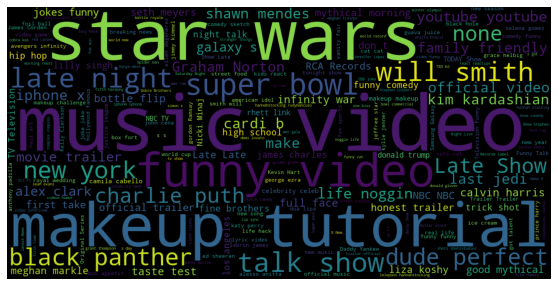

In [ ]:
# Plotting the generated Word Cloud

# The purpose of using plt.figure() is to create afigure object.
# figsize(float, float): These parameter are the 
# width, height in inches.

plt.figure(figsize=(15,5))

#  plt.imshow() function is used to display data as an image
plt.imshow(wordcloud_obj3)

# plt.axis() function is used to set some axis properties to the graph.
# eg --> plt.axis('off') is used to signify no axis
# eg --> plt.axis(0,10,1,15) is used to signify x axis will 
#        start from 0 and end at 10 and y axis will start 
#        from 1 and end at 15

plt.axis('off')

# Part 5: Analyzing 'Likes', 'Views' and ' Dislikes' to see how they are corelated

Text(0.5, 1.0, 'Regression Plot for Likes vs Views')

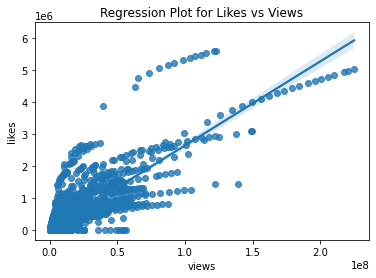

In [ ]:
# Using the seaborn library, we will plot regression plot
# to see the relation between likes and views

sns.regplot(data=USvideos, x='views', y='likes')

# Using the Matplot Library to give a title to the
# chart just generated

plt.title("Regression Plot for Likes vs Views")

Text(0.5, 1.0, 'Regression Plot for Dislikes vs Views')

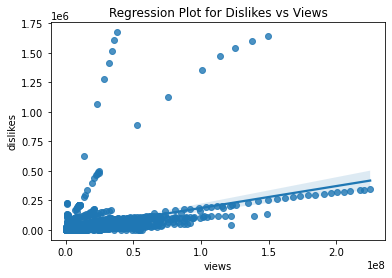

In [ ]:
# Using the seaborn library, we will plot regression plot
# to see the relation between likes and views

sns.regplot(data=USvideos, x='views', y='dislikes')

# Using the Matplot Library to give a title to the
# chart just generated

plt.title("Regression Plot for Dislikes vs Views")

In [ ]:
# Creating a dataFrame to store the features from the Original
# dataframe to calculate the correlation among them

# It consists of analysing the relationship 
# between at least two variables and it will 
# display the strength and direction of the relationship.

# A value of zero indicates no relationship between 
# the two variables being compared.
# A correlation coefficient greater than zero indicates a 
# positive relationship while a value less than zero 
# signifies a negative relationship

df_corr = USvideos[['views','likes','dislikes']]

In [ ]:
# Finding the correlation among the 3 features selected
# by using corr() function which will return a matrix

cor_matrix=df_corr.corr()

In [ ]:
cor_matrix

,views,likes,dislikes
views,1.000000,0.849177,0.472213
likes,0.849177,1.000000,0.447186
dislikes,0.472213,0.447186,1.000000


<AxesSubplot:>

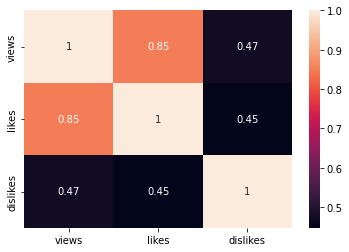

In [ ]:
# Plotting the correlation matrix using a heatmap via
# seaborn library

# Here annot = True --> It makes sure that the values are
# also displayed in the chart

sns.heatmap(cor_matrix,annot=True)

# Part 6: Analyzing the emojis present in the YouTube comments

In [ ]:
# Installing the Emoji library 

!pip install emoji

In [ ]:
# Importing the Emoji library which we just downloaded

import emoji

In [ ]:
# List comprehension

#Logic Explanation Here --> 
# i)   "comments['comment_text'][1]" signifies that we are just taking
#      the row no 2 (index = 1)
# ii)  "if c in emoji.UNICODE_EMOJI" signifies that if value of 
#      c is equal to a unicode value then it is stored in c
# iii) "c for c in comments['comment_text'][1]" signifies that c will
#      iterate in comment stored at index = 2 and store the value in "c"
#      only if the condition mentioned above is satisfied 

c1=[]
[c1 for c1 in comments['comment_text'][1] if c1 in emoji.UNICODE_EMOJI_ENGLISH]

['😂', '😂', '😂']

In [ ]:
c1

[]

In [ ]:
# Using the above logic we will now extract the emojis one by one from each row

# Defining an empty string to store each and every emoji extracted

s = ''

# Starting the for loop to extract emoji row by row

for i in comments['comment_text']:
    lis = [p for p in i if p in emoji.UNICODE_EMOJI_ENGLISH]  # List Comprehension
    for element in lis:                                       # Starting another for loop to store the emojis extracted in a particular row
        s = s+element                                         # Storing the emoji one by one

In [ ]:
s

'😂😂😂😭😭😭😢😢😢❤❤😂👏👇👇👇👇👇👇👇👇👇👇🌞😎😣😥😫😭✌😂👎🏻👎🏻👎🏻👎🏻😂🖕😘😘▶⏭⏮◀🔥🔥😊😊🤔🤔😂😂😂😂👏🏻👏🏻❤❤😜😍😍😅❤😍😍✌😂😂😂😊😂😂😂😂😏😏😭💔😊❤❤❤❤❤😂😂😊❤😂🤣✨🌈😘😂😂❤😊😂😊😂💗😂😊😊😊💖🐢😉😍😂😂💗💗😻😻❤😂😂❤❤🤗👌🏼👌🏼😂😂😂😂💖😩🙊♥♥♥😂😂😂💙💙💙💙💙💙😂😂😂❤❤❤😂😂😂😂😂😂😂😂😂😂😂😂😂😂😂😂😂😂😱😊😛🌳🌽🎃🚣🚂😂😂😊😕😋🤣😅😢💔😂😊🤡🙏🙏🙏👊🏿🙇🏽👋😅😅😅😅😂😂🤔😎😎😎😎😎😎😎😍😍😍😍😍😍😘😘😘😘😘😘😘😲🖕💪🤘💓☺☺😂😂😂💕😄😄😍💕😉😩❤❤💕❤😂💕😍💗👫💖😆💕💖💕😍😍😊😄😍😀💗🦄😍😊😂😊👍😍♥❤😂👶🏻🤗☺😘💙💙💙😍😍😊😎🤘🖤👌👌😍😂👌🍍😎😎😄😄😄😄😂😂😂😬💜💜💜😭😂😍😍💖😂😂😂😂😂😂😂😭😂😭😂😭😂😂😂😍😍😍😭😍😍😂👀👀🤔😂😂😂😂😂😂😂😂😂😂🍸🍸🍸🍸🍸😂😂😂🤣🤣🤣😂😂😂😂😍💜💜💜💜😂😂😂😅😂😍💖😂😻😉🔥❤😻❤😭😭😭😭😭😭😭👍🏻😍💚💙❤❤😫❤❤❤❤❤♥😍❤😊😍😎💄🐐😅😂😂😊😊👀👌🏽❤❤❤😂💖🎉💪💪🏽😎🙌🙌😜❤❤💛💛😎🙏💚🎉🎉❤🎉🎉🎉🎉🎊🎉🎊🎉😭💗😍😍😍😍😍😍😍👏✌😁❤❤😂💋💋👫💘😻💋💋😂👑🔥🔥🔥🔥🔥🔥🔥🔥🔥🔥😂😐😑😩👌🏻🔥💖👏🏻👀✨👅💦💕❤😍🔥🔥🔥❤❤❤❤❤❤❤👌😍😍😍😞🌴💜💜💜💜😍😍😍😍😍❤❤❤❤❤😊❤❤❤❤🍔🍟😒🌿😄😄😄😉🍲🍱🎏❤💪👊🏽😘😂😂😂❤🙋☺😍😍😚💕😉😂❤❤😊☺💓🌸🙄🙄🙄🙁😞😊🙄😍😨😍😍😍😍😎😃😂😍😏😌😂😎🤑😂😉👍🏻🔥💯🚨😊☺😂😂😂🤣🙂❤❤😀😀😀♥♥😂❤😂😓😭😂❤❤😖😖😂😂😂💗💝😘💐💐💐😂😍☺😂❤😭💕🙌🏽🙌🏽🙌🏽😘😘❤❤💖😫😖📱😂😏🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗😁🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗😎😂😂👍🏼💯💕♥♥♥😱😱😱❤❤❤😍😍😩😩😩😩😩😩😩😍😻😻😻😻😻😳🥀♥♥♥♥♥♥😍😍😍🙃😂💕💕💕😍💕💕❤❤💕😍🍫🌹💖❤😍👸🏿👸🏿👸🏿👸🏿👸🏿💗😊😊😩❤👌🏼😻😊😍❤😂😂👏🏼❤❤❤❤❤😍😍😍💚💚💚💚💚😍😭🌹😍❤😍😍😍💚💚💚💚💚😍💚💚💚☺💙😀😍💚😕😍👌😂😂😂😍👌🏻💗❤💚💚💚😸😙😙😘💚💚💚💚😍😭😭💖💓💓💓😍❤😘😘🤗🤗🤗❤😀😀💓💓💓❤😂❤😍❤❤♥♥♥❤🙌❤😂❤❤😍❤💜😍😭😍😍😍😊💗💕😍❤💗💗💛💛💛💖💖😍😐😍😍😍😍🗿😂🤗😩😩😩💖💖💖❤❤❤❤❤😍😍✨😍👍🏻😁😂😍💅❤😘❤❤😈👀😄😈👍☝👆✊👌✌👊✋👋👏👐👉👈💔😂😂😬😭😥☺😂😂😂😂😍😍😍😜😂😂😂😂😂😒👎🏽😱😱😱😱😂😎😛🙊✊✌😑😑😑👌😊😊😍😊❤❤❤❤😍

In [ ]:
# Now we have all the emojis stred in string variable named "s"
# So now to analyze the top emojis, we need count for every
# unique emoji

# For this we will make use of set() function which will give a 
# set of unique emojis and dictionary data structure wherein key
# will be emoji and value will be it's count

# s.count(variablle) --> It will return the total no of occurences 
#                          of that variable in string s
# dict[variable] = value --> It will save that value at key'variable'
#                            in the dictionary

# Defining an empty Dictionary to store the emojis and its count
# as key value pair

result = {}

# Starting the For Loop

for j in set(s):
    result[j] = s.count(j)  #storing the emoji as key and its count as the value in the dictionary named result

In [ ]:
result

{'🗾': 6,
 '🛤': 5,
 '🤵': 4,
 '⚡': 196,
 '🐥': 117,
 '🍝': 22,
 '🈂': 5,
 '🕚': 618,
 '🦁': 39,
 '🎟': 6,
 '💳': 41,
 '🔃': 5,
 '📁': 61,
 '🌤': 10,
 '👩': 222,
 '🌸': 324,
 '🦓': 1,
 '😹': 273,
 '🙆': 158,
 '⛔': 14,
 '🔚': 5,
 '🤶': 7,
 '🖕': 1019,
 '🐢': 24,
 '🚡': 12,
 '🕷': 99,
 '⌨': 5,
 '🦉': 7,
 '🧤': 1,
 '😽': 70,
 '📃': 36,
 '🏮': 5,
 '😇': 626,
 '🤣': 2374,
 '💌': 26,
 '🔋': 22,
 '🚉': 5,
 '😂': 43947,
 '🐮': 30,
 '🍻': 46,
 '⚪': 56,
 '🆖': 5,
 '🆔': 5,
 '➗': 11,
 '🌭': 25,
 '📈': 12,
 '🌦': 19,
 '🛬': 4,
 '💺': 9,
 '🔗': 7,
 '🤑': 157,
 '🗄': 4,
 '🏓': 6,
 '🕐': 7,
 '📇': 10,
 '😈': 331,
 '🐛': 30,
 '💞': 1393,
 '🎩': 29,
 '💨': 84,
 '⚰': 21,
 '🏌': 4,
 '🎍': 17,
 '↖': 5,
 '🤥': 21,
 '🛣': 4,
 '📕': 10,
 '🥟': 1,
 '🤕': 35,
 '🕖': 534,
 '🌑': 13,
 '🏊': 12,
 '😚': 583,
 '🎰': 16,
 '🏪': 7,
 '⚔': 10,
 '📧': 6,
 '⏰': 8,
 '🌶': 45,
 '🌝': 53,
 '🐞': 100,
 '🗿': 18,
 '🍿': 38,
 '🗻': 11,
 '🚰': 10,
 '🚹': 6,
 '🎤': 316,
 '🔀': 6,
 '🚐': 6,
 '🗝': 9,
 '🕞': 7,
 '🦄': 544,
 '📓': 21,
 '🚤': 7,
 '💿': 929,
 '🎛': 7,
 '🔔': 45,
 '👦': 84,
 '🙇': 50,
 '🏗': 15,
 '🌐': 27,
 

In [ ]:
# Now we have created a dictionary named result which has all the unique
# emojis present in the comments
# Now we will sort the dictionary based on the count/frequency

# For Sorting, we will make use of sorted() function
# sorted() takes three parameters from which two are optional.
# Iterable :          sequence (list, tuple, string) or collection 
#                     (dictionary, set, frozenset) or any other iterator 
#                     that needs to be sorted.
# Key(optional) :     A function that would server as a key or a basis of
#                     sort comparison.
# Reverse(optional) : If set true, then the iterable would be sorted in
#                     reverse (descending) order, by default it is set as false.

# Defining a dictionary named final which will  have emojis and their count in
# ascending order
final = {}

# Here "lambda item:item[1]" will iterate through all the items list value
# present at the first index (index of key is 0 and value is 1)

for key,value in sorted(result.items(), key= lambda item:item[1]):
    final[key]=value
    
    

In [ ]:
final

{'🦓': 1,
 '🧤': 1,
 '🥟': 1,
 '🛒': 1,
 '🥜': 1,
 '🤾': 1,
 '🥌': 1,
 '🧣': 1,
 '🥡': 1,
 '🦏': 1,
 '🥚': 1,
 '🥨': 1,
 '🤽': 1,
 '🤺': 1,
 '🧠': 1,
 '🤟': 1,
 '🤹': 1,
 '🛷': 1,
 '🧡': 2,
 '🧛': 2,
 '🥅': 2,
 '🦕': 2,
 '🤱': 2,
 '🦔': 2,
 '🧒': 2,
 '🎌': 2,
 '🧝': 2,
 '🧘': 2,
 '🦖': 2,
 '🧢': 2,
 '🤯': 3,
 '🧐': 3,
 '🤨': 3,
 '🥖': 3,
 '🥄': 3,
 '🤫': 3,
 '🤵': 4,
 '🛬': 4,
 '🗄': 4,
 '🏌': 4,
 '🛣': 4,
 '⏯': 4,
 '🥈': 4,
 '🧟': 4,
 '🥞': 4,
 '🤬': 4,
 '🦆': 4,
 '☦': 4,
 '⏸': 4,
 '⏏': 4,
 '⏲': 4,
 '🗂': 4,
 '♟': 4,
 '♾': 4,
 '🗓': 4,
 '⚙': 4,
 '🦐': 4,
 '🖍': 4,
 '🥝': 4,
 '☸': 4,
 '⚗': 4,
 '🖇': 4,
 '🏷': 4,
 '🦍': 4,
 '💹': 4,
 '⚧': 4,
 '🛢': 4,
 '⏹': 4,
 '🛤': 5,
 '🈂': 5,
 '🔃': 5,
 '🔚': 5,
 '⌨': 5,
 '🏮': 5,
 '🚉': 5,
 '🆖': 5,
 '🆔': 5,
 '↖': 5,
 '🛋': 5,
 '🈵': 5,
 '↔': 5,
 '🤮': 5,
 '🔂': 5,
 '🧜': 5,
 'Ⓜ': 5,
 '🚛': 5,
 '🛥': 5,
 '➿': 5,
 '🦒': 5,
 '🈁': 5,
 '◻': 5,
 '⚾': 5,
 '⛏': 5,
 '🖼': 5,
 '🚻': 5,
 '♠': 5,
 '◽': 5,
 '🈲': 5,
 '🗜': 5,
 '🈳': 5,
 '🔁': 5,
 '↕': 5,
 '🔖': 5,
 '🗒': 5,
 '🗳': 5,
 '🔠': 5,
 '🕎': 5,
 '🚎': 5,
 '🗃': 5,
 '🖊': 5,
 '🔲': 5,
 

In [ ]:
# Unzipping the above dictionary using the * operator

# Here all the keys will be unzipped in a list and stored in a variable
# named Keys

Keys = [*final.keys()]

# Here all the valuess will be unzipped in a list and stored in a variable
# named Values

Values = [*final.values()]


In [ ]:
Keys

['🦓',
 '🧤',
 '🥟',
 '🛒',
 '🥜',
 '🤾',
 '🥌',
 '🧣',
 '🥡',
 '🦏',
 '🥚',
 '🥨',
 '🤽',
 '🤺',
 '🧠',
 '🤟',
 '🤹',
 '🛷',
 '🧡',
 '🧛',
 '🥅',
 '🦕',
 '🤱',
 '🦔',
 '🧒',
 '🎌',
 '🧝',
 '🧘',
 '🦖',
 '🧢',
 '🤯',
 '🧐',
 '🤨',
 '🥖',
 '🥄',
 '🤫',
 '🤵',
 '🛬',
 '🗄',
 '🏌',
 '🛣',
 '⏯',
 '🥈',
 '🧟',
 '🥞',
 '🤬',
 '🦆',
 '☦',
 '⏸',
 '⏏',
 '⏲',
 '🗂',
 '♟',
 '♾',
 '🗓',
 '⚙',
 '🦐',
 '🖍',
 '🥝',
 '☸',
 '⚗',
 '🖇',
 '🏷',
 '🦍',
 '💹',
 '⚧',
 '🛢',
 '⏹',
 '🛤',
 '🈂',
 '🔃',
 '🔚',
 '⌨',
 '🏮',
 '🚉',
 '🆖',
 '🆔',
 '↖',
 '🛋',
 '🈵',
 '↔',
 '🤮',
 '🔂',
 '🧜',
 'Ⓜ',
 '🚛',
 '🛥',
 '➿',
 '🦒',
 '🈁',
 '◻',
 '⚾',
 '⛏',
 '🖼',
 '🚻',
 '♠',
 '◽',
 '🈲',
 '🗜',
 '🈳',
 '🔁',
 '↕',
 '🔖',
 '🗒',
 '🗳',
 '🔠',
 '🕎',
 '🚎',
 '🗃',
 '🖊',
 '🔲',
 '🔤',
 '❎',
 '↪',
 '🌫',
 '🛂',
 '🔼',
 '☂',
 '🧖',
 'ℹ',
 '🗞',
 '🚁',
 '⚒',
 '🥉',
 '🔢',
 '🈴',
 '🖨',
 '↩',
 '🚟',
 '🔡',
 '🎐',
 '⛴',
 '⏺',
 '⛩',
 '🈯',
 '🔄',
 '🔳',
 '🔣',
 '♦',
 '🖲',
 '🥛',
 '🆎',
 '🈹',
 '🕹',
 '⛱',
 '⛸',
 '㊙',
 '🚠',
 '✡',
 '🗾',
 '🎟',
 '🏓',
 '📧',
 '🚹',
 '🔀',
 '🚐',
 '⤵',
 '🛃',
 '⏮',
 '⏱',
 '🛠',
 '🥋',
 '🕍',
 '㊗',
 '🚇',
 '🧙',
 '🖌'

In [ ]:
# Creating a Dataframe to store the top 20 emojis

# Negative index slicing = Keys[-20] or Values[-20] --> It tells to take all
# the 20 elements from the back of the list

# "pd.DataFrame({'chars':Keys[-20:],'count':Values[-20:]})" --> Here the name
# of columns of the DataFrame are also defined during the initialization 
# which are chars and count and their values as well via negative index slicing
Top20_emojis = pd.DataFrame({'emojis':Keys[c],'count':Values[-20:]})
Top20_emojis


,emojis,count
0,🙌,2734
1,🏼,2961
2,💙,2968
3,💗,3071
4,👌,3534
5,💜,3616
6,🏻,4412
7,💖,4809
8,😊,4946
9,👏,5357


In [ ]:
# We will use Plotly to plot the visualization here

# Plotly provides online graphing, analytics, and statistics tools
# for individuals and collaboration, as well as scientific graphing
# libraries for Python, R

# iplot --> It is used Draw plotly graphs inside an IPython notebook 
# without connecting to an external server. 

import plotly.graph_objs as go

from plotly.offline import iplot





In [ ]:
# Creating an object named trace and then calling the
# graph object alias "go" to plot the bar chart
# with X axis as Emojis and Y axis as their Count

trace = go.Bar(
x=Top20_emojis['emojis'],
y=Top20_emojis['count'])



In [ ]:
# Plotting the graph by passing the object in iplot

iplot([trace])

